In [2]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt

# Dataset info

## Columns

Input variables:
* **bank client data:**
    1) age (numeric)
    2) job : type of job (categorical: "admin.","unknown","unemployed","management","housemaid","entrepreneur","student",
                                           "blue-collar","self-employed","retired","technician","services") 
    3) marital : marital status (categorical: "married","divorced","single"; note: "divorced" means divorced or widowed)
    4) education (categorical: "unknown","secondary","primary","tertiary")
    5) default: has credit in default? (binary: "yes","no")
    6) balance: average yearly balance, in euros (numeric) 
    7) housing: has housing loan? (binary: "yes","no")
    8) loan: has personal loan? (binary: "yes","no")
* **related with the last contact of the current campaign:**
    9) contact: contact communication type (categorical: "unknown","telephone","cellular") 
    10) day: last contact day of the month (numeric)
    11) month: last contact month of year (categorical: "jan", "feb", "mar", ..., "nov", "dec")
    12) duration: last contact duration, in seconds (numeric)
* **other attributes:**
    13) campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)
    14) pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric, -1 means client was not previously contacted)
    15) previous: number of contacts performed before this campaign and for this client (numeric)
    16) poutcome: outcome of the previous marketing campaign (categorical: "unknown","other","failure","success")

* **Output variable (desired target):**
    17) y - has the client subscribed a term deposit? (binary: "yes","no")

# Import data

In [10]:
df_raw = pd.read_csv("../data/bank-additional/bank-additional-full.csv", sep=";")
df_raw = df_raw.rename(columns={"emp.var.rate": "emp_var_rate", 
                                "cons.price.idx": "cons_price_idx", 
                                "cons.conf.idx": "cons_conf_indx",
                                "nr.employed": "nr_employed"
                               }
                      )

df_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp_var_rate    41188 non-null  float64
 16  cons_price_idx  41188 non-null  float64
 17  cons_conf_indx  41188 non-null 

Notes:
* Missing `balance`
* More useful `day_of_week`
* New variables
    * emp.var.rate
    * cons.price.idx
    * cons.conf.idx
    * euribor3m
    * nr.employed

# Inspect data

## Graphing and Utility Functions

### `make_prop_hist_cat()`

In [16]:
def make_prop_hist_cat(df, col, cat_order=None, outside=False):
    
    fig = px.histogram(df,
                       x=col,
                       color="y",
                       barmode="group",
                       category_orders = {col: cat_order},
                       histnorm="percent",
                       width=600,
                       height=400,
                       template="plotly_white",
                       text_auto=".0f",
                       labels={"y": "Marketing Campaign Call Success"}
            )
    
    fig.update_traces(textangle=0)
    
    if outside:
        fig.update_traces(
            textposition="outside"
        ) 
        
    
    return fig

### `make_cat_col_df()`

In [17]:
def make_cat_col_df(df, col, bins):
    df_col = df.loc[:, [col, "y"]]
    
    bins = bins
    labels = ["-".join((str(bins[i]), str(bins[i+1]))) for i in range(len(bins)-1)]
    
    df_col[f"{col}_cat"] = pd.cut(df_col[col], bins=bins, labels=labels, include_lowest=True)
    
    return df_col

### `make_cat_col()`

In [18]:
def make_cat_col(df, col, bins):
    df_col = df.loc[:, [col, "y"]]
    
    bins = bins
    labels = ["-".join((str(bins[i]), str(bins[i+1]))) for i in range(len(bins)-1)]
    
    df_col[f"{col}_cat"] = pd.cut(df_col[col], bins=bins, labels=labels)
    
    return pd.cut(df_col[col], bins=bins, labels=labels, include_lowest=True)

## Overall

In [7]:
df_raw.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [5]:
df_raw.describe()

,age,balance,day,duration,campaign,pdays,previous
count,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000
mean,40.936210,1362.272058,15.806419,258.163080,2.763841,40.197828,0.580323
std,10.618762,3044.765829,8.322476,257.527812,3.098021,100.128746,2.303441
min,18.000000,-8019.000000,1.000000,0.000000,1.000000,-1.000000,0.000000
25%,33.000000,72.000000,8.000000,103.000000,1.000000,-1.000000,0.000000
50%,39.000000,448.000000,16.000000,180.000000,2.000000,-1.000000,0.000000
75%,48.000000,1428.000000,21.000000,319.000000,3.000000,-1.000000,0.000000
max,95.000000,102127.000000,31.000000,4918.000000,63.000000,871.000000,275.000000


In [8]:
df_raw.corr()

<ipython-input-8-b1b9f67e3b65>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df_raw.corr()


,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
age,1.000000,-0.000866,0.004594,-0.034369,0.024365,-0.000371,0.000857,0.129372,0.010767,-0.017725
duration,-0.000866,1.000000,-0.071699,-0.047577,0.020640,-0.027968,0.005312,-0.008173,-0.032897,-0.044703
campaign,0.004594,-0.071699,1.000000,0.052584,-0.079141,0.150754,0.127836,-0.013733,0.135133,0.144095
pdays,-0.034369,-0.047577,0.052584,1.000000,-0.587514,0.271004,0.078889,-0.091342,0.296899,0.372605
previous,0.024365,0.020640,-0.079141,-0.587514,1.000000,-0.420489,-0.203130,-0.050936,-0.454494,-0.501333
emp.var.rate,-0.000371,-0.027968,0.150754,0.271004,-0.420489,1.000000,0.775334,0.196041,0.972245,0.906970
cons.price.idx,0.000857,0.005312,0.127836,0.078889,-0.203130,0.775334,1.000000,0.058986,0.688230,0.522034
cons.conf.idx,0.129372,-0.008173,-0.013733,-0.091342,-0.050936,0.196041,0.058986,1.000000,0.277686,0.100513
euribor3m,0.010767,-0.032897,0.135133,0.296899,-0.454494,0.972245,0.688230,0.277686,1.000000,0.945154
nr.employed,-0.017725,-0.044703,0.144095,0.372605,-0.501333,0.906970,0.522034,0.100513,0.945154,1.000000


## y (class labels)

### histogram - count

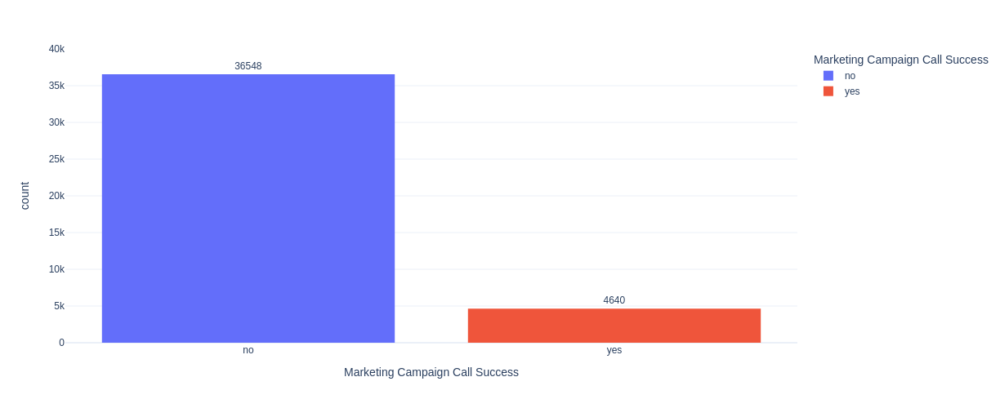

In [15]:
fig = px.histogram(df_raw,
             x="y",
             color="y",
             width=600,
             height=500,
             template="plotly_white",
             text_auto = "0.0f",
             labels={"y": "Marketing Campaign Call Success"},
                   range_y = [0, 40000]
            )

fig.update_layout(
    font_family = "Arial",
)
fig.update_traces(
            textposition="outside"
        )

# fig.update_xaxes(title_font_family="Arial")

In [67]:
len(df)

45211

### histogram - percent

In [13]:
df_y = df_raw.loc[:, ["y", "age"]].groupby("y").agg("count").reset_index()
df_y.columns = ["y", "count"]

df_y["percent"] = df_y["count"] / df_y["count"].sum() * 100
df_y

,y,count,percent
0,no,36548,88.734583
1,yes,4640,11.265417


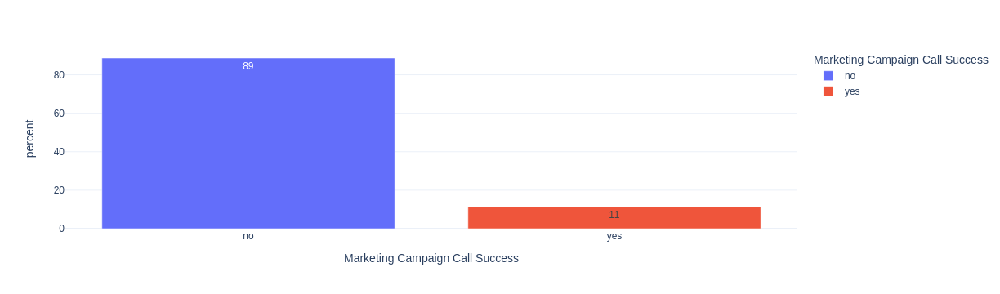

In [14]:
px.bar(df_y,
       x="y",
       y="percent",
       color="y",
       width=600,
       height=300,
       template="plotly_white",
       text_auto="0.0f",
       labels={"y": "Marketing Campaign Call Success"},
      )

## age (num)

### histograms

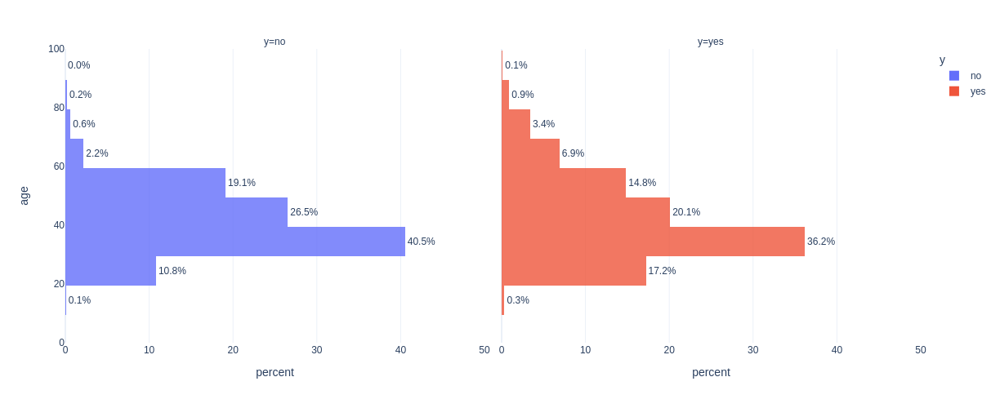

In [71]:
fig=px.histogram(df_raw,
             # x="age",
                 y="age",
             color="y",
             nbins=10,
             barmode="overlay",
             opacity=0.8,
             histnorm="percent",
             facet_col="y",
             width=800,
             height=500,
             template="plotly_white",
             text_auto = True,
                 range_x=[0, 50],
                 range_y=[0,100]
       )

fig.update_traces(
    marker_line_width = 0, 
    texttemplate = "%{value:.1f}%",
    textangle=0,
    textfont_size=12,
    textposition="outside"
) 

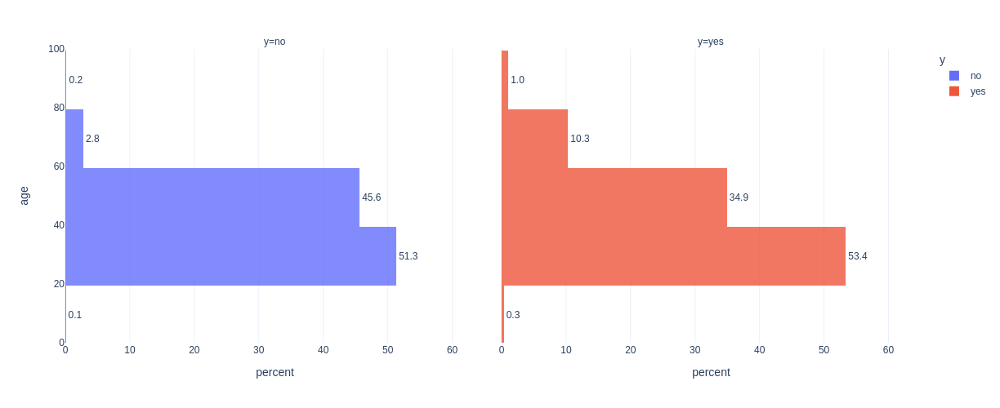

In [120]:
fig=px.histogram(df_raw,
             # x="age",
                 y="age",
             color="y",
             nbins=5,
             barmode="overlay",
             opacity=0.8,
             histnorm="percent",
                              # cumulative=True,
             facet_col="y",
             width=800,
             height=500,
             template="plotly_white",
             text_auto = ".1f",
                 range_x=[0, 65],
                 range_y=[0,100]
       )

fig.update_traces(
    # marker_line_width = 0, 
    # texttemplate = "%{value:.1f}%",
    textangle=0,
    textfont_size=12,
    textposition="outside"
) 

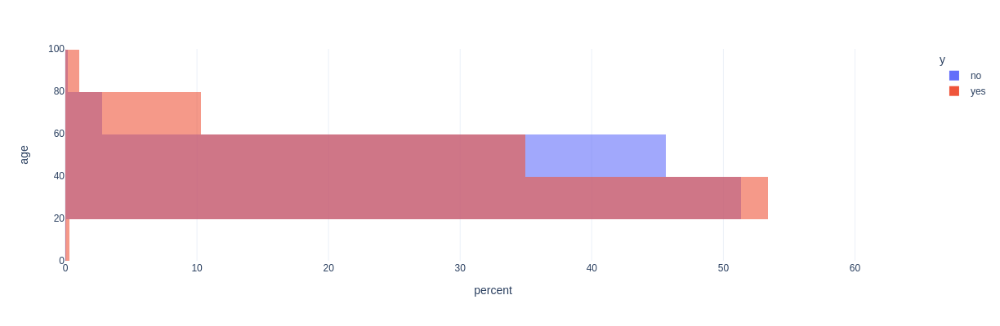

In [69]:
fig=px.histogram(df_raw,
             # x="age",
                 y="age",
             color="y",
             nbins=5,
             barmode="overlay",
             opacity=0.6,
             histnorm="percent",
                              # cumulative=True,
             # facet_col="y",
             width=600,
             height=400,
             template="plotly_white",
             # text_auto = ".1f",
                 range_x=[0, 65],
                 range_y=[0,100]
       )

fig.update_traces(
    # marker_line_width = 0, 
    # texttemplate = "%{value:.1f}%",
    textangle=0,
    textfont_size=12,
    textposition="outside"
) 

### heat maps

### new column: age_cat (cat)

In [84]:
# age_bins = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
age_bins = [18, 30, 40, 60, 80, 100]
age_labels = ["-".join((str(age_bins[i]), str(age_bins[i+1]))) for i in range(len(age_bins)-1)]
df_age = make_cat_col_df(df_raw, "age", age_bins)
df_age

,age,y,age_cat
0,56,no,40-60
1,57,no,40-60
2,37,no,30-40
3,40,no,30-40
4,56,no,40-60
...,...,...,...
41183,73,yes,60-80
41184,46,no,40-60
41185,56,no,40-60
41186,44,yes,40-60


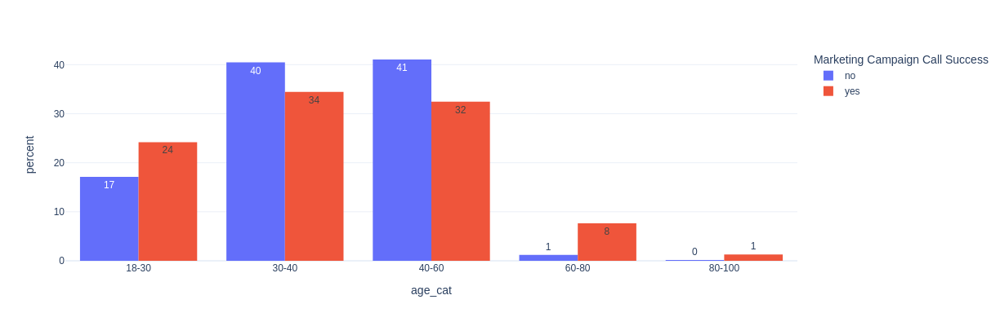

In [85]:
# age_bins = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
# df_age = make_cat_col_df(df_raw, "age", age_bins)
# df_age

make_prop_hist_cat(df_age, "age_cat", cat_order=age_labels)

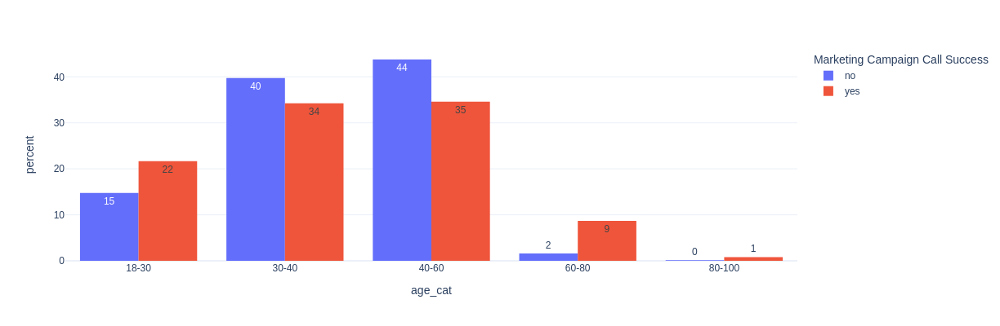

In [90]:
fig = px.histogram(df_age,
                       x="age_cat",
                       color="y",
                       barmode="group",
                       category_orders = {"age_cat": age_labels},
                       histnorm="percent",
                       width=600,
                       height=400,
                       template="plotly_white",
                       text_auto=".0f",
                   # range_y = [0, 50],
                   labels={"y": "Marketing Campaign Call Success"}
            )

# fig.update_traces(textposition="outside")
fig.show()

## job (cat)

In [183]:
dfr_job_gba = (df_raw.loc[:, ["job", "y", "age"]]
               .groupby(["y", "job"])
               .agg(["count"])
               .reset_index()
              )

job_counts = pd.DataFrame(df_raw["job"].value_counts()).reset_index().rename(columns={"index":"job", "job": "job_total_count"})

dfr_job_gba.columns=["y", "job", "counts"]
dfr_job_gba = dfr_job_gba.merge(job_counts, how="inner", on="job")

dfr_job_gba["prop_by_job"] = dfr_job_gba["counts"] / dfr_job_gba["job_total_count"] * 100
dfr_job_gba

,y,job,counts,job_total_count,prop_by_job
0,no,admin.,4540,5171,87.797331
1,yes,admin.,631,5171,12.202669
2,no,blue-collar,9024,9732,92.725031
3,yes,blue-collar,708,9732,7.274969
4,no,entrepreneur,1364,1487,91.728312
5,yes,entrepreneur,123,1487,8.271688
6,no,housemaid,1131,1240,91.209677
7,yes,housemaid,109,1240,8.790323
8,no,management,8157,9458,86.244449
9,yes,management,1301,9458,13.755551


In [204]:
job_sorted_lst = dfr_job_gba[dfr_job_gba["y"] == "yes"].sort_values(["prop_by_job", "job"], ascending=False)["job"].to_list()
job_sorted_lst

['student',
 'retired',
 'unemployed',
 'management',
 'admin.',
 'self-employed',
 'unknown',
 'technician',
 'services',
 'housemaid',
 'entrepreneur',
 'blue-collar']

### bar chart

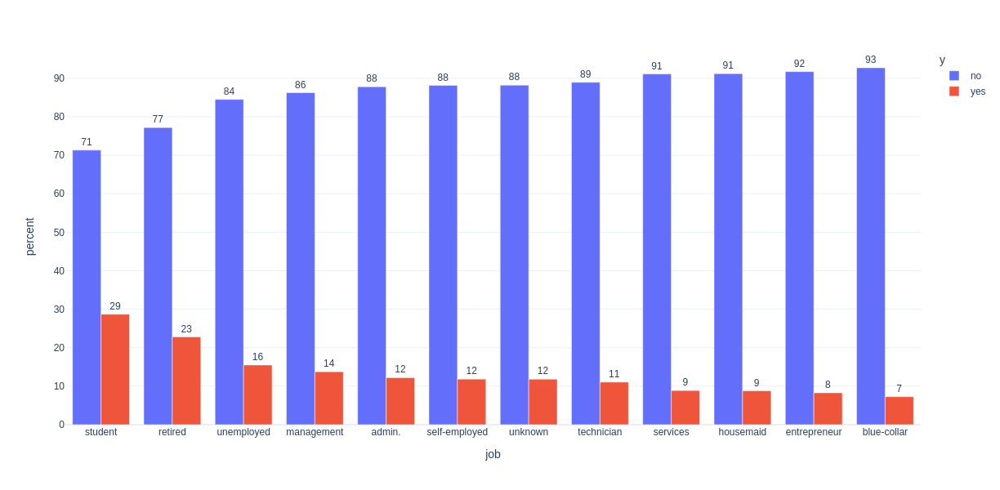

In [207]:
fig = px.bar(dfr_job_gba,
             y="prop_by_job",
             x="job",
             color="y",
             # facet_col="job",
             # facet_col_wrap=3,
             category_orders={"job": job_sorted_lst},
             barmode="group",
             width=800,
             height=600,
             template="plotly_white",
             text_auto=".0f",
             labels={"prop_by_job": "percent"},
            )
fig.update_traces(
    # marker_line_width = 0, 
    # texttemplate = "%{value:.1f}%",
    # textangle=0,
    textfont_size=12,
    textposition="outside"
) 
fig.show()

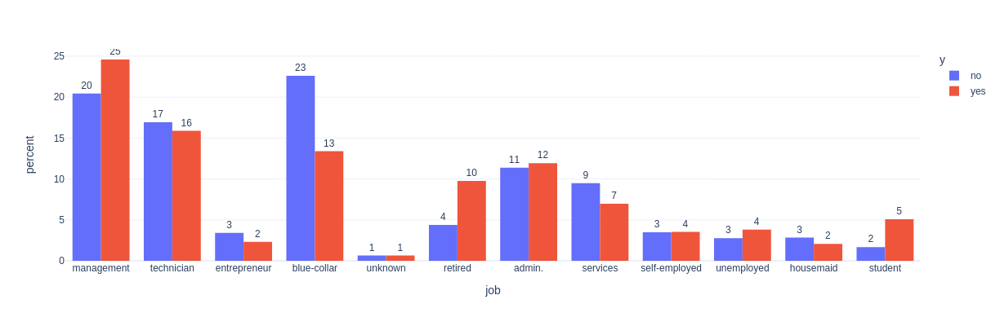

In [299]:
make_prop_hist_cat(df_raw, "job", outside=True)

In [302]:
job_sorted_lst = dfr_job_gba[dfr_job_gba["y"] == "yes"].sort_values(["prop_by_job", "job"], ascending=False)["job"].to_list()
job_sorted_lst

['student',
 'retired',
 'unemployed',
 'management',
 'admin.',
 'self-employed',
 'unknown',
 'technician',
 'services',
 'housemaid',
 'entrepreneur',
 'blue-collar']

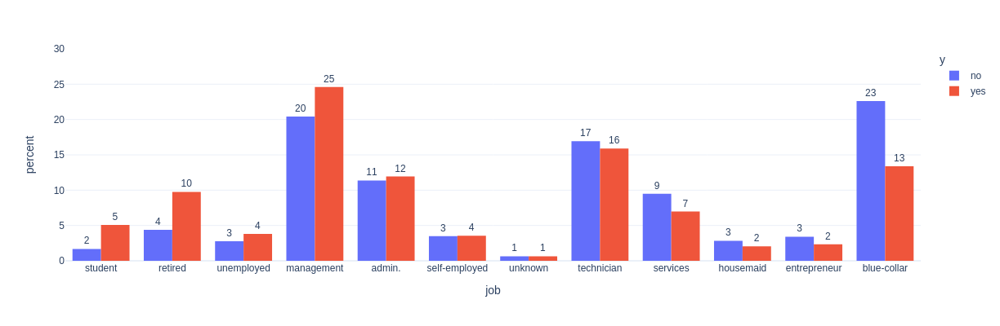

In [304]:
fig = px.histogram(df_raw,
                    x="job",
                    color="y",
                    barmode="group",
                    category_orders = {"job": job_sorted_lst},
                    histnorm="percent",
                    width=600,
                    height=400,
                    template="plotly_white",
                    text_auto=".0f",
                   range_y=[0, 30]
            )
    
fig.update_traces(textangle=0, textposition="outside")

## marital (cat)

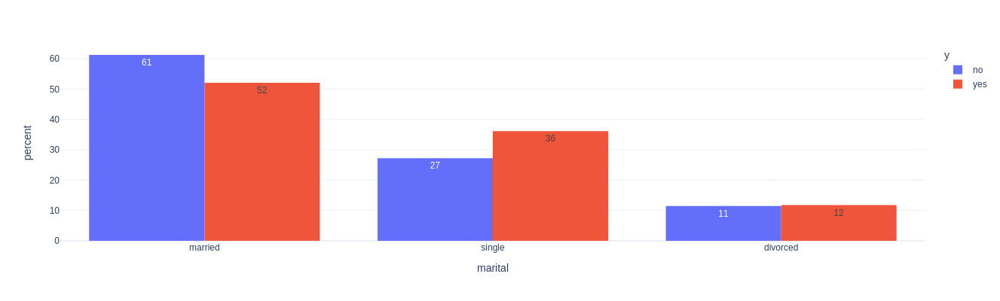

In [217]:
fig = px.histogram(df_raw,
             x="marital",
             color="y",
             barmode="group",
             histnorm="percent",
             width=600,
             height=400,
             template="plotly_white",
             text_auto=".0f"
            )

# fig.update_traces(
#     # marker_line_width = 0, 
#     # texttemplate = "%{value:.1f}%",
#     # textangle=0,
#     textfont_size=12,
#     textposition="outside"
# ) 
fig.show()

In [236]:
def make_prop_hist_cat(df, col, cat_order=None, outside=False):
    
    fig = px.histogram(df,
                       x=col,
                       color="y",
                       barmode="group",
                       category_orders = {col: cat_order},
                       histnorm="percent",
                       width=600,
                       height=400,
                       template="plotly_white",
                       text_auto=".0f"
            )
    
    fig.update_traces(textangle=0)
    
    if outside:
        fig.update_traces(
            textposition="outside"
        ) 
        
    
    return fig

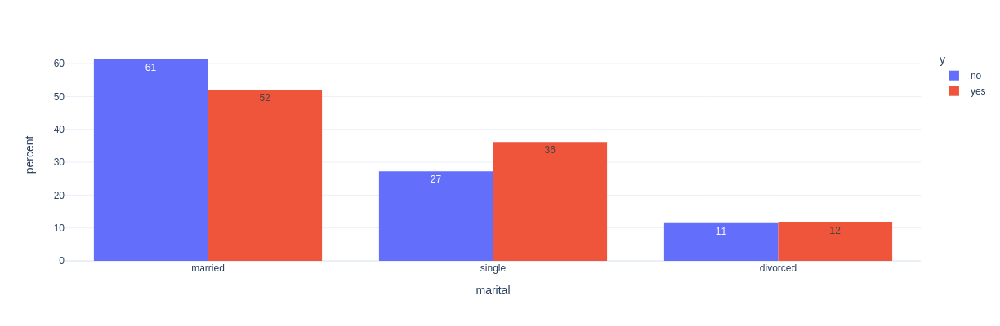

In [237]:
make_prop_hist_cat(df_raw, "marital")

## education (cat)

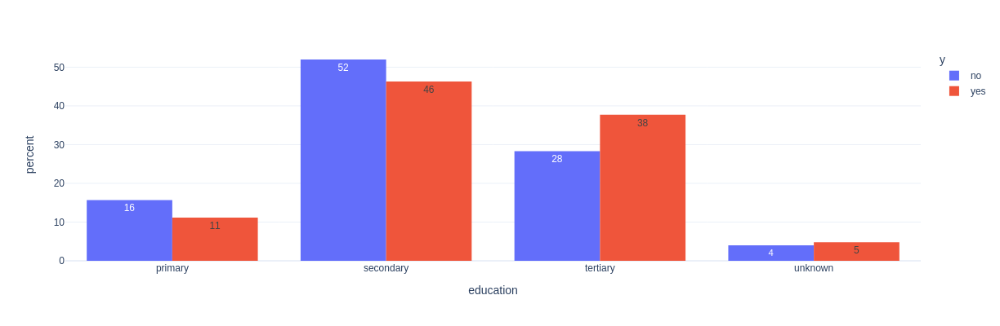

In [238]:
make_prop_hist_cat(df_raw, "education", ["primary", "secondary", "tertiary", "unknown"]
                   # outside=True
                  )

## default (cat)

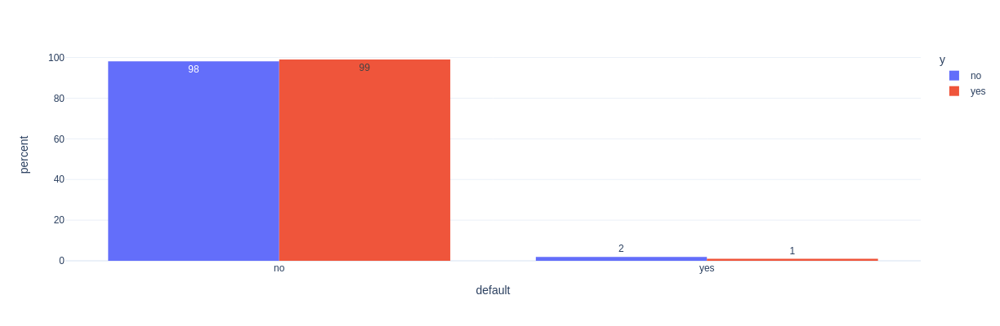

In [239]:
make_prop_hist_cat(df_raw, "default")

## REMOVED - balance (num)

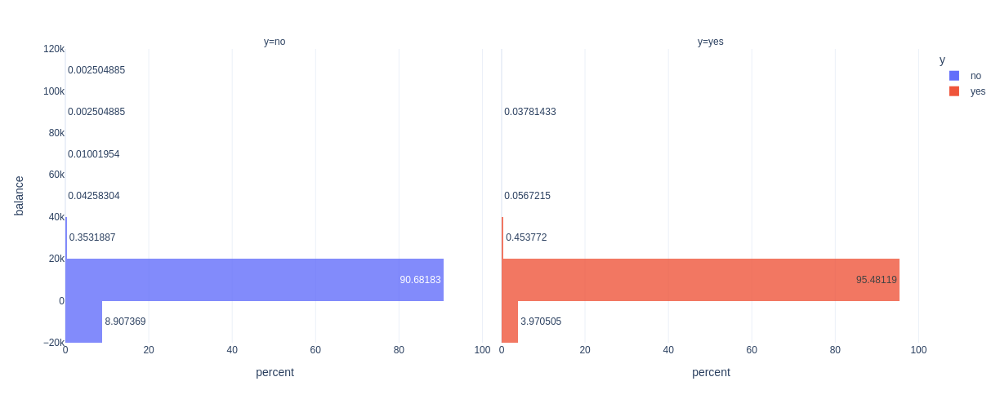

In [326]:
fig=px.histogram(df_raw,
             # x="age",
                 y="balance",
             color="y",
             nbins=10,
             barmode="overlay",
             opacity=0.8,
             histnorm="percent",
             facet_col="y",
             width=800,
             height=500,
             template="plotly_white",
             text_auto = True,
                 # range_x=[0, 50],
                 # range_y=[0,100]
       )

# fig.update_traces(
#     marker_line_width = 0, 
#     texttemplate = "%{value:.1f}%",
#     textangle=0,
#     textfont_size=12,
#     textposition="outside"
# ) 

fig.show()

In [327]:
df_raw["balance"].describe()

count     45211.000000
mean       1362.272058
std        3044.765829
min       -8019.000000
25%          72.000000
50%         448.000000
75%        1428.000000
max      102127.000000
Name: balance, dtype: float64

In [337]:
df_bal["balance"].max()

102127

### new column: balance_cat

In [182]:
df_bal = df_raw.loc[:, ["balance", "y"]]

# balance_bins = [-10000, 0, 100, 500, 1000, 2000, 10000, 110000]
balance_bins = [-10000, 0, 1000, 10000, 110000]
# balance_bins = [-10000, 1000, 10000, 110000]
# balance_bins = [-10000, 0, 1000, 110000]
balance_labels = ["-".join((str(balance_bins[i]), str(balance_bins[i+1]))) for i in range(len(balance_bins)-1)]

df_bal["balance_cat"] = pd.cut(df["balance"], bins=balance_bins, labels=balance_labels)
df_bal

,balance,y,balance_cat
0,2143,no,1000-10000
1,29,no,0-1000
2,2,no,0-1000
3,1506,no,1000-10000
4,1,no,0-1000
...,...,...,...
45206,825,yes,0-1000
45207,1729,yes,1000-10000
45208,5715,yes,1000-10000
45209,668,no,0-1000


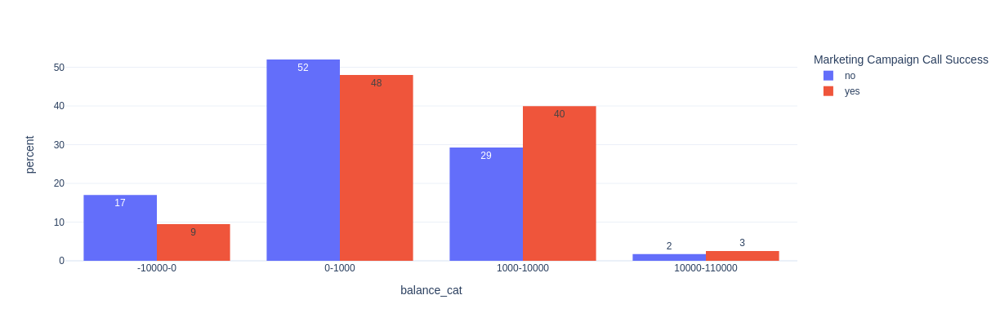

In [184]:
make_prop_hist_cat(df_bal, "balance_cat", balance_labels)

## housing (cat)

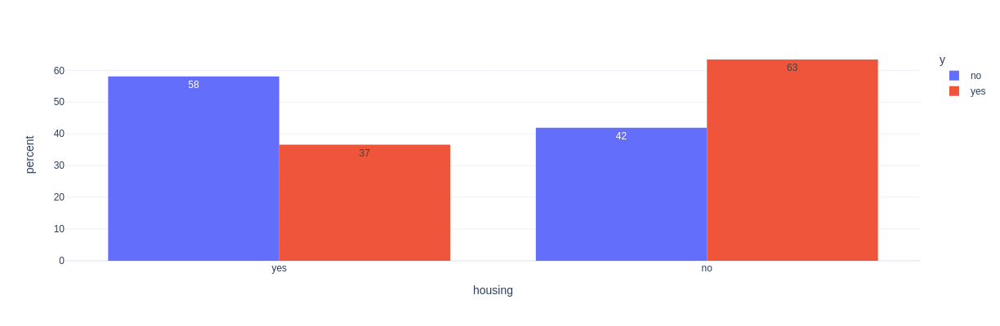

In [240]:
make_prop_hist_cat(df_raw, "housing")

## loan (cat)

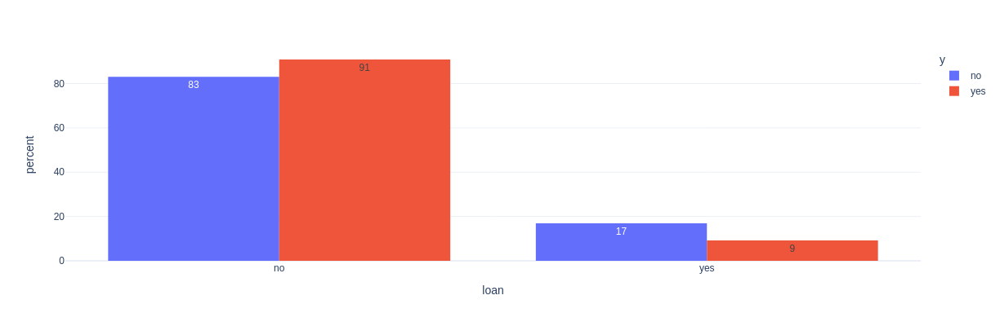

In [241]:
make_prop_hist_cat(df_raw, "loan")

## contact (cat)

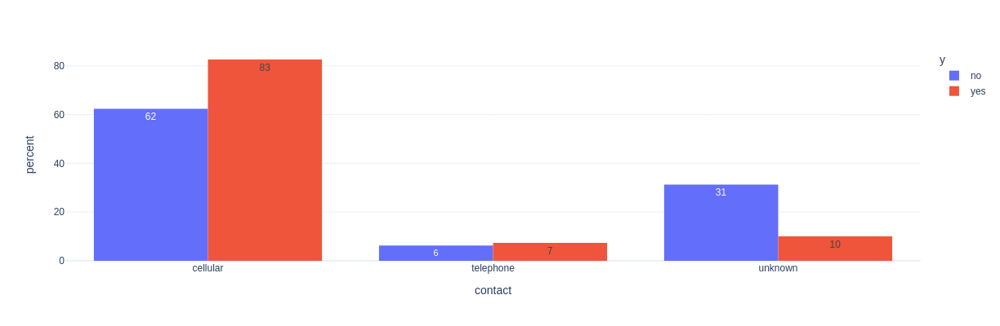

In [243]:
make_prop_hist_cat(df_raw, "contact", ["cellular", "telephone", "unknown"])

## REMOVED - day (num)

In [244]:
df_raw["day"].describe()

count    45211.000000
mean        15.806419
std          8.322476
min          1.000000
25%          8.000000
50%         16.000000
75%         21.000000
max         31.000000
Name: day, dtype: float64

In [245]:
df_raw["day"].head()

0    5
1    5
2    5
3    5
4    5
Name: day, dtype: int64

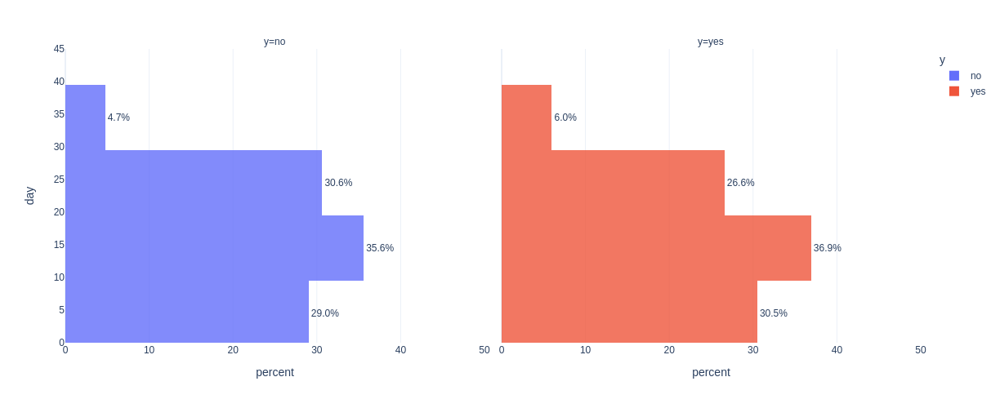

In [252]:
fig=px.histogram(df_raw,
             # x="age",
                 y="day",
                 color="y",
                 nbins=4,
                 barmode="overlay",
                 opacity=0.8,
                 histnorm="percent",
                 facet_col="y",
                 width=800,
                 height=500,
                 template="plotly_white",
                 text_auto = True,
                 range_x=[0, 50],
                 range_y=[0,45]
       )

fig.update_traces(
    marker_line_width = 0, 
    texttemplate = "%{value:.1f}%",
    textangle=0,
    textfont_size=12,
    textposition="outside"
) 

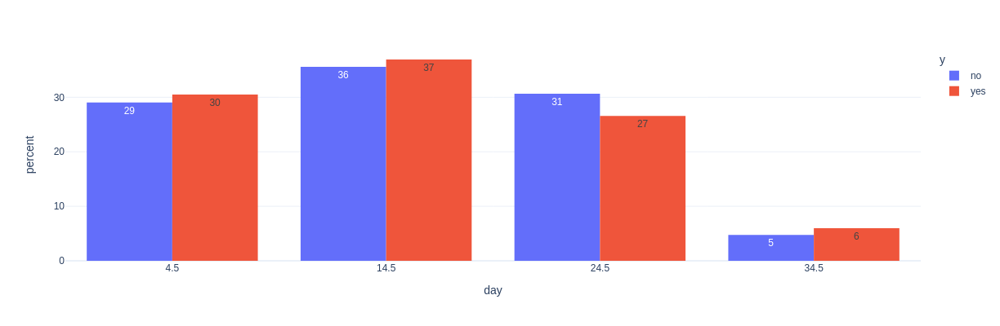

In [253]:
fig = px.histogram(df_raw,
                       x="day",
                       color="y",
                   nbins=4,
                       barmode="group",
                       # category_orders = {col: cat_order},
                       histnorm="percent",
                       width=600,
                       height=400,
                       template="plotly_white",
                       text_auto=".0f"
            )

fig.update_traces(textangle=0)

In [340]:
df_raw["day"].describe()

count    45211.000000
mean        15.806419
std          8.322476
min          1.000000
25%          8.000000
50%         16.000000
75%         21.000000
max         31.000000
Name: day, dtype: float64

### new column: day_cat

In [356]:
df_day = make_cat_col_df(df_raw, "day", [1, 7, 14, 21, 31])
df_day

,day,y,day_cat
0,5,no,1-7
1,5,no,1-7
2,5,no,1-7
3,5,no,1-7
4,5,no,1-7
...,...,...,...
45206,17,yes,14-21
45207,17,yes,14-21
45208,17,yes,14-21
45209,17,no,14-21


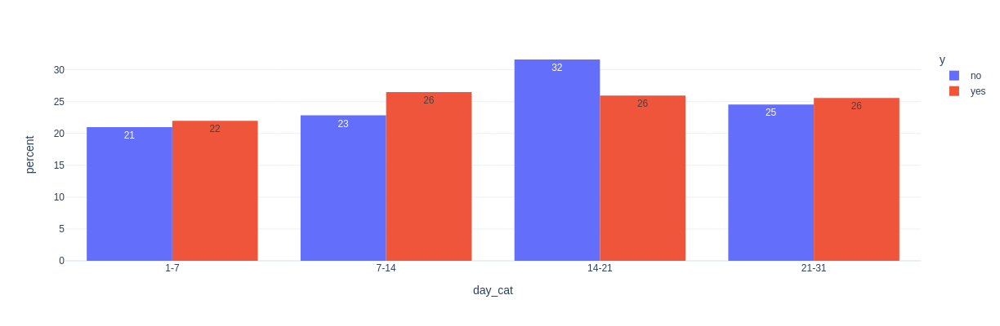

In [357]:
make_prop_hist_cat(df_day, "day_cat")

In [352]:
make_cat_col(df_raw, "day", [1, 7, 14, 21, 31])

0          1-7
1          1-7
2          1-7
3          1-7
4          1-7
         ...  
45206    14-21
45207    14-21
45208    14-21
45209    14-21
45210    14-21
Name: day, Length: 45211, dtype: category
Categories (4, object): ['1-7' < '7-14' < '14-21' < '21-31']

In [ ]:
df_day = df_raw.loc[:, ["day", "y"]]
day_bins = [1, 7, 14, 21, 31]
day_labels = ["-".join((str(day_bins[i]), str(day_bins[i+1]))) for i in range(len(day_bins)-1)]

df_day["day_cat"] = pd.cut(df["day"], bins=day_bins, labels=day_labels)
df_bal

## month (cat)

In [260]:
months = ['jan',
 'feb',
 'mar',
 'apr',
 'may',
 'jun',
 'jul',
 'aug',
 'sep',
 'oct',
 'nov',
 'dec']

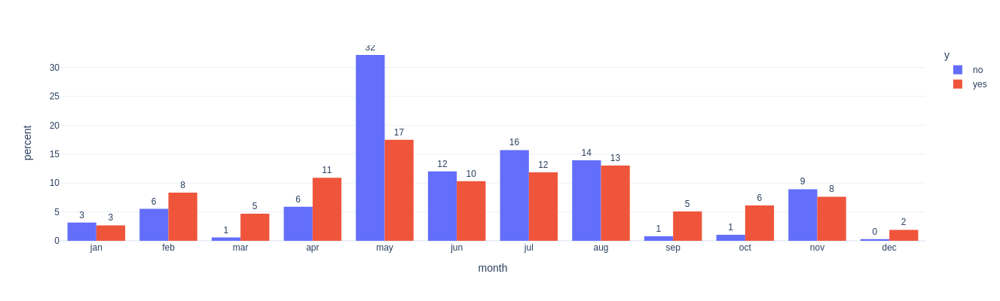

In [262]:
make_prop_hist_cat(df_raw, "month", months, outside=True)

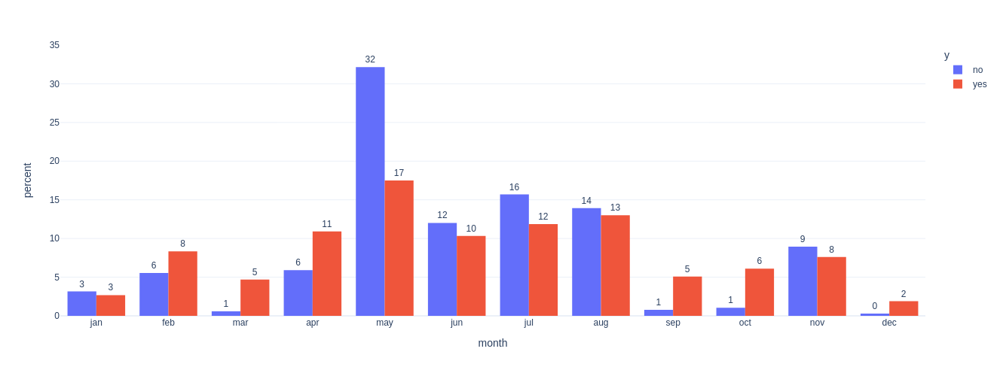

In [269]:
fig = px.histogram(df_raw,
                       x="month",
                       color="y",
                       barmode="group",
                       category_orders = {"month": months},
                       histnorm="percent",
                       width=800,
                       height=500,
                       template="plotly_white",
                       text_auto=".0f",
                   range_y = [0, 35],
            )
    
fig.update_traces(textangle=0, textposition="outside")

fig.show()

## duration (num)
duration: last contact duration, in seconds (numeric)

### new column: duration_min_cat

In [70]:
df_raw_dur["duration_min"].describe()

count    41188.000000
mean         4.304750
std          4.321321
min          0.000000
25%          1.700000
50%          3.000000
75%          5.316667
max         81.966667
Name: duration_min, dtype: float64

In [71]:
df_raw_dur = df_raw.loc[:, ["duration", "y"]]
df_raw_dur["duration_min"] = df_raw_dur["duration"]/60

# dur_min_bins = [0, 5, 10, 15, 20, 30, 45, 60]
# dur_min_bins = [0, 5, 10, 15, 30, 60]
dur_min_bins = [0, 2, 3, 5, 90]
dur_min_labels = ["-".join((str(dur_min_bins[i]), str(dur_min_bins[i+1]))) for i in range(len(dur_min_bins)-1)]
df_raw_dur["duration_min_cat"] = pd.cut(df_raw_dur["duration_min"], bins=dur_min_bins, labels=dur_min_labels)

df_raw_dur["duration_min_cat"].value_counts()

0-2     12913
5-90    11204
3-5      9279
2-3      7788
Name: duration_min_cat, dtype: int64

In [80]:
dur_lst = []

for val in df_raw_dur["duration_min"]:
    if val >=0 and val <=1:
        dur_lst.append("0-1")
    elif val >1 and val <= 2:
        dur_lst.append("1-2")
    elif val >2 and val <= 5:
        dur_lst.append("2-5")
    elif val > 5:
        dur_lst.append(">5")
        
dur_min_cat_labels = ["0-1", "1-2", "2-5", ">5"]

In [77]:
df_raw_dur["duration_min_cat"] = dur_lst

In [78]:
df_raw_dur

,duration,y,duration_min,duration_min_cat
0,261,no,4.350000,2-5
1,149,no,2.483333,2-5
2,226,no,3.766667,2-5
3,151,no,2.516667,2-5
4,307,no,5.116667,>5
...,...,...,...,...
41183,334,yes,5.566667,>5
41184,383,no,6.383333,>5
41185,189,no,3.150000,2-5
41186,442,yes,7.366667,>5


In [66]:
# make_prop_hist_cat(df_raw_dur, "duration_min_cat", dur_min_labels)

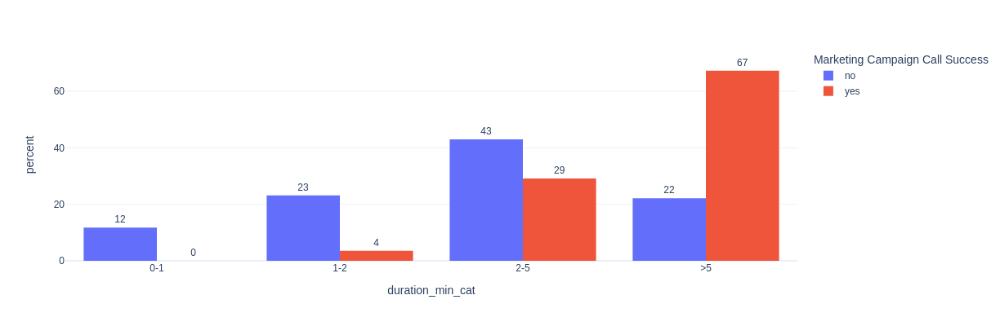

In [87]:
fig = px.histogram(df_raw_dur,
                       x="duration_min_cat",
                       color="y",
                       barmode="group",
                       category_orders = {"duration_min_cat": dur_min_cat_labels},
                       histnorm="percent",
                       width=600,
                       height=400,
                       template="plotly_white",
                       text_auto=".0f",
                   range_y = [0, 75],
                   labels={"y": "Marketing Campaign Call Success"}
            )

fig.update_traces(textposition="outside")
fig.show()

## campaign (num)
  13 - campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)

<AxesSubplot: >

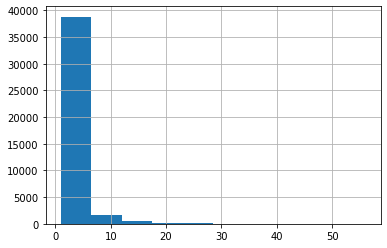

In [19]:
df_raw["campaign"].hist()

In [20]:
df_raw["campaign"].describe()

count    41188.000000
mean         2.567593
std          2.770014
min          1.000000
25%          1.000000
50%          2.000000
75%          3.000000
max         56.000000
Name: campaign, dtype: float64

### new column: campaign_cat

In [21]:
df_campaign = make_cat_col_df(df_raw, "campaign", [0, 1, 2, 3, 10, 63])
df_campaign

,campaign,y,campaign_cat
0,1,no,0-1
1,1,no,0-1
2,1,no,0-1
3,1,no,0-1
4,1,no,0-1
...,...,...,...
41183,1,yes,0-1
41184,1,no,0-1
41185,2,no,1-2
41186,1,yes,0-1


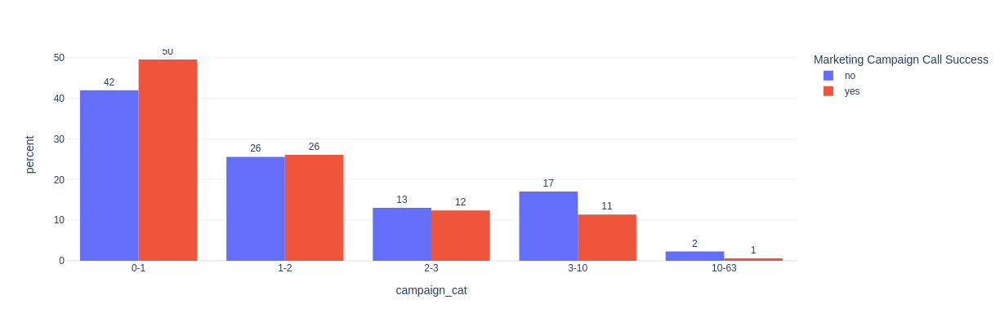

In [22]:
make_prop_hist_cat(df_campaign, "campaign_cat", outside=True)

In [49]:
lst = []

for val in df_raw["campaign"]:
    if val == 0:
        lst.append("0")
    elif val == 1:
        lst.append("1")
    elif val == 2:
        lst.append("2")
    elif val >=3 and val <= 5:
        lst.append("3-5")
    elif val > 5:
        lst.append(">5")

In [50]:
df_camp = df_raw.loc[:, ["campaign", "y"]]
campaign_labels = ["0", "1", "2", "3-5", ">5"]
df_camp["campaign_cat"] = pd.Series(lst)
df_camp

,campaign,y,campaign_cat
0,1,no,1
1,1,no,1
2,1,no,1
3,1,no,1
4,1,no,1
...,...,...,...
41183,1,yes,1
41184,1,no,1
41185,2,no,2
41186,1,yes,1


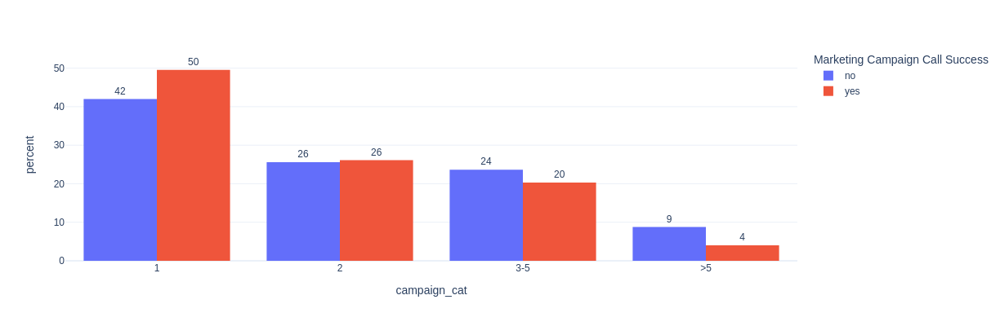

In [51]:
fig = px.histogram(df_camp,
                       x="campaign_cat",
                       color="y",
                       barmode="group",
                       category_orders = {"campaign_cat": campaign_labels},
                       histnorm="percent",
                       width=600,
                       height=400,
                       template="plotly_white",
                       text_auto=".0f",
                   range_y = [0, 55],
                   labels={"y": "Marketing Campaign Call Success"}
            )

fig.update_traces(textposition="outside")
fig.show()

## pdays (num)
  14 - pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric, -1 means client was not previously contacted)

In [96]:
df_raw["pdays"].describe()

count    41188.000000
mean       962.475454
std        186.910907
min          0.000000
25%        999.000000
50%        999.000000
75%        999.000000
max        999.000000
Name: pdays, dtype: float64

### new column: pdays_cat

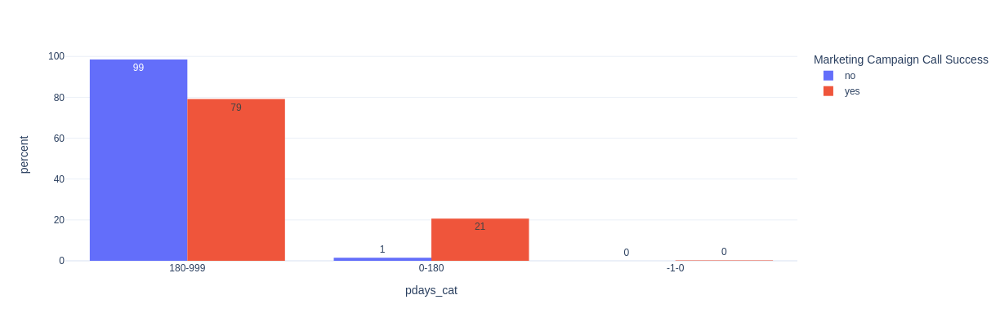

In [97]:
df_pdays = make_cat_col_df(df_raw, "pdays", [-1, 0, 180, 999])

make_prop_hist_cat(df_pdays, "pdays_cat")

## previous (num)
15 - previous: number of contacts performed before this campaign and for this client (numeric)

In [39]:
df_raw["previous"].describe()

count    41188.000000
mean         0.172963
std          0.494901
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          7.000000
Name: previous, dtype: float64

### new column: previous_cat

In [ ]:
fig = px.histogram(df_camp,
                       x="campaign_cat",
                       color="y",
                       barmode="group",
                       category_orders = {"campaign_cat": campaign_labels},
                       histnorm="percent",
                       width=600,
                       height=400,
                       template="plotly_white",
                       text_auto=".0f",
                   range_y = [0, 55],
                   labels={"y": "Marketing Campaign Call Success"}
            )

fig.update_traces(textposition="outside")
fig.show()

In [44]:
prev_lst = []

for val in df_raw["previous"]:
    if val == 0:
        prev_lst.append("0")
    elif val == 1:
        prev_lst.append("1")
    elif val == 2:
        prev_lst.append("2")
    elif val >=3 and val <= 5:
        prev_lst.append("3-5")
    elif val > 5:
        prev_lst.append(">5")

In [46]:
df_previous = df_raw.loc[:, ["previous", "y"]]
previous_labels = ["0", "1", "2", "3-5", ">5"]
df_previous["previous_cat"] = prev_lst

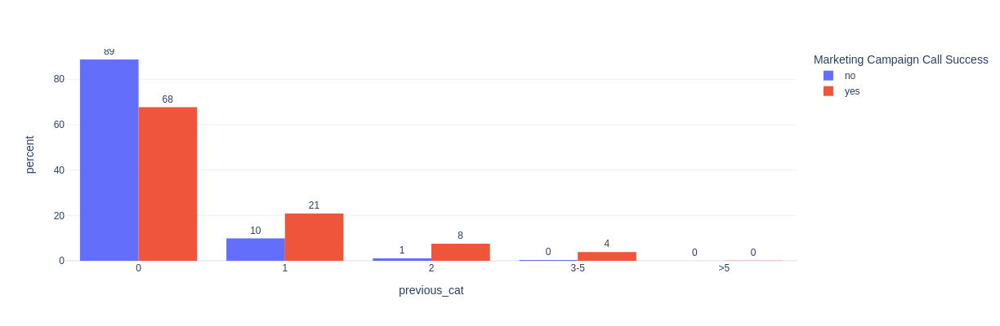

In [48]:
fig = px.histogram(df_previous,
                       x="previous_cat",
                       color="y",
                       barmode="group",
                       category_orders = {"previous_cat": previous_labels},
                       histnorm="percent",
                       width=600,
                       height=400,
                       template="plotly_white",
                       text_auto=".0f",
                   # range_y = [0, 55],
                   labels={"y": "Marketing Campaign Call Success"}
            )

fig.update_traces(textposition="outside")
fig.show()

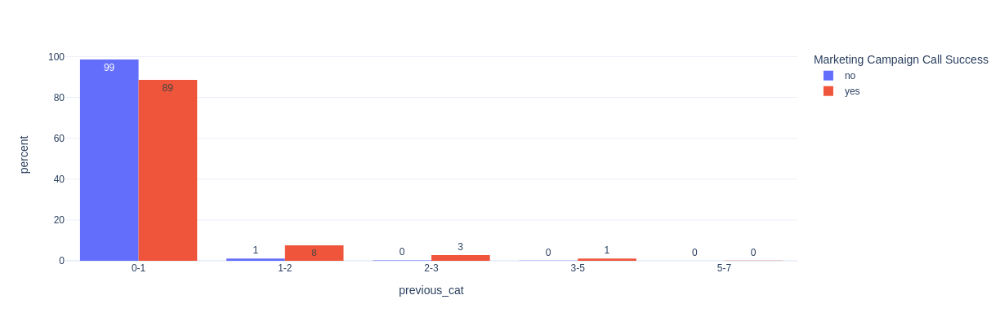

In [41]:
previous_bins = [0, 1, 2, 3, 5, 7]
df_previous = make_cat_col_df(df_raw, "previous", previous_bins)

make_prop_hist_cat(df_previous, "previous_cat")

In [12]:
df_previous["first_contact"] = np.where(df_raw["previous"] == 0, "yes", "no")

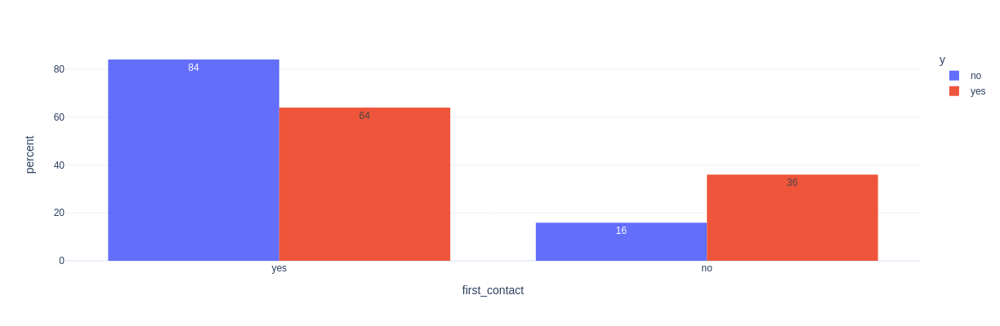

In [13]:
make_prop_hist_cat(df_previous, "first_contact")

In [11]:
df_previous

,previous,y,previous_cat,first_contact
0,0,no,0-1,no
1,0,no,0-1,no
2,0,no,0-1,no
3,0,no,0-1,no
4,0,no,0-1,no
...,...,...,...,...
45206,0,yes,0-1,no
45207,0,yes,0-1,no
45208,3,yes,2-3,no
45209,0,no,0-1,no


## poutcome (cat)
  16 - poutcome: outcome of the previous marketing campaign (categorical: "unknown","other","failure","success")

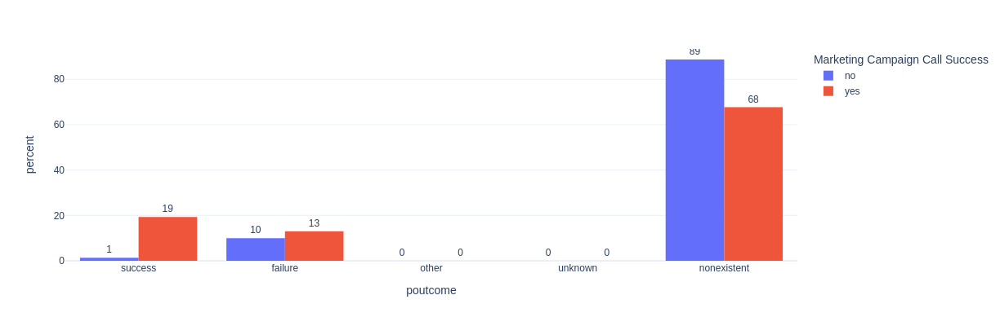

In [52]:
make_prop_hist_cat(df_raw, "poutcome", ["success", "failure", "other", "unknown"], outside=True)

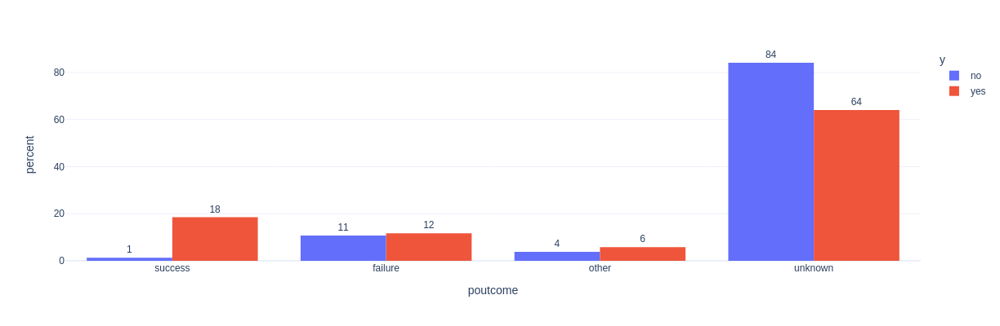

In [297]:
fig = px.histogram(df_raw,
                       x="poutcome",
                       color="y",
                       barmode="group",
                       category_orders = {"poutcome": ["success", "failure", "other", "unknown"]},
                       histnorm="percent",
                       width=600,
                       height=400,
                   range_y=[0,90],
                       template="plotly_white",
                       text_auto=".0f"
            )

fig.update_traces(textangle=0, textposition="outside")

# Entropies

## Entropy functions

In [88]:
'''
Function for identifying indices for elements of input 1-dimensional array @arr that are equal to input @val.

Returns list of indices that can be later passed on to filter down other arrays (e.g. if @arr is class labels y, use to filter down y and corresponding values for given label in X).
'''
def ind_where_true(arr, val):
            
    ind_lst = [i for i in range(len(arr)) if arr[i] == val]
            
    return ind_lst

In [89]:
def calc_E(feat_arr, Y):
    tol = 1e-9
    E_dict = {} # dictionary to track terms summed for weight-averaged entropy calculation
    
    x_unique = np.unique(feat_arr)
    y_unique = np.unique(Y)
    
    for val in x_unique:
        filt_ind = ind_where_true(feat_arr, val)
        
        Y_filt = Y[filt_ind]
        
        H = 0
        for label in y_unique:
            prob_label = len(Y_filt[Y_filt == label]) / len(Y_filt) # Probability of label in filtered Y corresponding to x_unique
            # print(f"prob_label for {label} is {prob_label}")
            H += -(prob_label) * np.emath.logn(len(y_unique), prob_label+tol)
            
        # print(f"H for {val} is {H}")
        
        
        C_n = (len(Y_filt) / len(Y))
        # print(f"C_i/N = {C_n}")
        E_dict[val] =  C_n * H
        # print(f"  E for {val} is {E_dict[val]}")
            
    E_feat = np.array(list(E_dict.values())).sum()
    
    return E_feat

In [14]:
calc_E(df["age_cat"], df["y"])

H for 10-20 is 0.925015870860202
  E for 10-20 is 0.001984617448705837
H for 20-30 is 0.6352472958366928
  E for 20-30 is 0.09741367149666656
H for 30-40 is 0.47670827358765056
  E for 30-40 is 0.18649309316194676
H for 40-50 is 0.438690365568707
  E for 40-50 is 0.10905401381581248
H for 50-60 is 0.47068300060746554
  E for 50-60 is 0.08398398102011512
H for 60-70 is 0.973875521188351
  E for 60-70 is 0.015100014163655615
H for 70-80 is 0.9930698143564771
  E for 70-80 is 0.00852250753069636
H for 80-90 is 0.9780709680881059
  E for 80-90 is 0.0019902795572782233
H for 90-100 is 0.863120565681241
  E for 90-100 is 0.00013363659197471162


0.5046758147868516

In [411]:
df.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'y', 'age_cat', 'balance_cat', 'day_cat',
       'duration_min', 'duration_min_cat', 'campaign_cat', 'pdays_cat',
       'previous_cat'],
      dtype='object')

## df, with cat columns

In [109]:
np.where(df["balance"] > 1000, "yes", "no")

array(['yes', 'no', 'no', ..., 'yes', 'no', 'yes'], dtype='<U3')

In [ ]:
age_bins = [18, 30, 40, 60, 80, 100]
age_labels = ["-".join((str(age_bins[i]), str(age_bins[i+1]))) for i in range(len(age_bins)-1)]

In [126]:
df = df_raw.copy()

age_bins = [18, 30, 40, 60, 80, 100]
age_labels = ["-".join((str(age_bins[i]), str(age_bins[i+1]))) for i in range(len(age_bins)-1)]
df["age_cat"] = pd.cut(df["age"], bins=age_bins, labels=age_labels, include_lowest=True).astype(str)

# # balance_bins = [-10000, 0, 100, 500, 1000, 2000, 10000, 110000]
# balance_bins = [-10000, 0, 1000, 110000]
# balance_labels = ["-".join((str(balance_bins[i]), str(balance_bins[i+1]))) for i in range(len(balance_bins)-1)]

# df["balance_cat"] = pd.cut(df["balance"], bins=balance_bins, labels=balance_labels, include_lowest=True)
# df["balance_split"] = np.where(df["balance"] > 1000, "yes", "no")

# df["day_cat"] = make_cat_col(df, "day", [1, 7, 14, 21, 31])

# df["duration_min"] = df["duration"]/60
# dur_min_bins = [0, 5, 10, 15, 20, 30, 45, 60]
# dur_min_labels = ["-".join((str(dur_min_bins[i]), str(dur_min_bins[i+1]))) for i in range(len(dur_min_bins)-1)]
# df["duration_min_cat"] = pd.cut(df["duration_min"], bins=dur_min_bins, labels=dur_min_labels, include_lowest=True)

dur_lst = []

for val in df_raw_dur["duration_min"]:
    if val >=0 and val <=1:
        dur_lst.append("0-1")
    elif val >1 and val <= 2:
        dur_lst.append("1-2")
    elif val >2 and val <= 5:
        dur_lst.append("2-5")
    elif val > 5:
        dur_lst.append(">5")
        
dur_min_cat_labels = ["0-1", "1-2", "2-5", ">5"]

df["duration_min_cat"] = dur_lst

lst = []

for val in df_raw["campaign"]:
    if val == 0:
        lst.append("0")
    elif val == 1:
        lst.append("1")
    elif val == 2:
        lst.append("2")
    elif val >=3 and val <= 5:
        lst.append("3-5")
    elif val > 5:
        lst.append(">5")
        
# df = df_raw.loc[:, ["campaign", "y"]]
# campaign_labels = ["0", "1", "2", "3-5", ">5"]
df["campaign_cat"] = pd.Series(lst)

# df["campaign_cat"] = make_cat_col(df_raw, "campaign", [0, 1, 2, 3, 10, 63])

# df["pdays_cat"] = make_cat_col(df_raw, "pdays", [-1, 0, 90, 180, 365, 900])
df["pdays_cat"] = make_cat_col(df_raw, "pdays", [-1, 0, 180, 999])
                               
# df["previous_cat"] = make_cat_col(df_raw, "previous", [0, 1, 2, 3, 4, 5, 50, 300])

prev_lst = []

for val in df_raw["previous"]:
    if val == 0:
        prev_lst.append("0")
    elif val == 1:
        prev_lst.append("1")
    elif val == 2:
        prev_lst.append("2")
    elif val >=3 and val <= 5:
        prev_lst.append("3-5")
    elif val > 5:
        prev_lst.append(">5")

df["previous_cat"] = prev_lst

# df["first_contact"] = np.where(df_raw["previous"] == 0, "yes", "no")

In [99]:
for col in df.columns:
    print(f"'{col}',")

'age',
'job',
'marital',
'education',
'default',
'housing',
'loan',
'contact',
'month',
'day_of_week',
'duration',
'campaign',
'pdays',
'previous',
'poutcome',
'emp_var_rate',
'cons_price_idx',
'cons_conf_indx',
'euribor3m',
'nr_employed',
'y',
'age_cat',
'duration_min_cat',
'campaign_cat',
'pdays_cat',
'previous_cat',


In [101]:
feat_cat = [
    # 'age', # num
    'job',
    'marital',
    'education',
    'default',
    # 'balance', # num
    'housing',
    'loan',
    'contact',
    'day_of_week',
    'month',
    # 'duration', # num
    # 'campaign', # num
    # 'pdays', # num
    # 'previous', # num
    'poutcome',
    # 'y', # class label
    # 'age_cat',
    # 'balance_cat',
    # 'balance_split',
    # 'day_cat',
    # 'duration_min',
    # 'duration_min_cat',
    # 'campaign_cat',
    # 'pdays_cat',
    # "previous_cat",
    # "first_contact",
]

In [127]:
entropy_dict = {"features": feat_cat,
                "entropy": []
               }

for feat in feat_cat:
    entropy_dict["entropy"].append(calc_E(df[feat], df["y"]))

KeyboardInterrupt: 

In [103]:
df_entropy = pd.DataFrame(entropy_dict)
df_entropy.sort_values("entropy", ascending=True)

,features,entropy
9,poutcome,0.464036
8,month,0.469774
6,contact,0.491069
0,job,0.493647
3,default,0.499540
2,education,0.504423
1,marital,0.505802
7,day_of_week,0.507406
4,housing,0.507771
5,loan,0.507851


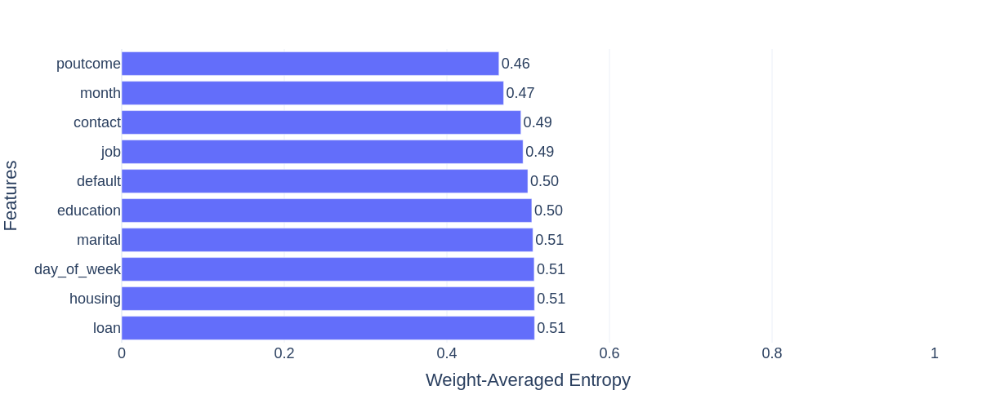

In [104]:
fig = px.bar(df_entropy.sort_values("entropy", ascending=False),
             y="features",
             x="entropy",
             template="plotly_white",
             width=600,
             height=500,
             text_auto="0.2f",
             range_x = [0, 1],
            )

fig.update_traces(textposition="outside")

fig.update_layout(
    # title="Plot Title",
    xaxis_title="Weight-Averaged Entropy",
    yaxis_title="Features",
    # legend_title="Legend Title",
    font=dict(
        family="Arial",
        size=18,
        # color="RebeccaPurple"
    )
)

fig.show()

In [128]:
feat_cat = [
    # 'age', # num
    'job',
    'marital',
    'education',
    'default',
    # 'balance', # num
    'housing',
    'loan',
    'contact',
    'day_of_week',
    'month',
    # 'duration', # num
    # 'campaign', # num
    # 'pdays', # num
    # 'previous', # num
    'poutcome',
    # 'y', # class label
    'age_cat',
    # 'balance_cat',
    # 'balance_split',
    # 'day_cat',
    # 'duration_min',
    'duration_min_cat',
    'campaign_cat',
    'pdays_cat',
    "previous_cat",
    # "first_contact",
]

In [129]:
df["age_cat"]

0        40-60
1        40-60
2        30-40
3        30-40
4        40-60
         ...  
41183    60-80
41184    40-60
41185    40-60
41186    40-60
41187    60-80
Name: age_cat, Length: 41188, dtype: object

In [132]:
entropy_dict = {"features": feat_cat,
                "entropy": [],
                "cat_label": []
               }

for feat in feat_cat:
    entropy_dict["entropy"].append(calc_E(df[feat], df["y"]))
    if "cat" in feat:
        entropy_dict["cat_label"].append("Numeric -> Categorical")
    else:
        entropy_dict["cat_label"].append("Categorical")
    
    
df_entropy2 = pd.DataFrame(entropy_dict)
df_entropy2.sort_values("entropy", ascending=True)

,features,entropy,cat_label
11,duration_min_cat,0.426626,Numeric -> Categorical
13,pdays_cat,0.463386,Numeric -> Categorical
9,poutcome,0.464036,Categorical
8,month,0.469774,Categorical
14,previous_cat,0.480134,Numeric -> Categorical
6,contact,0.491069,Categorical
10,age_cat,0.492088,Numeric -> Categorical
0,job,0.493647,Categorical
3,default,0.499540,Categorical
12,campaign_cat,0.504193,Numeric -> Categorical


In [137]:
df_entropy2["cat_label"].unique()

array(['Categorical', 'Numeric -> Categorical'], dtype=object)

In [135]:
cat_graph_sort = df_entropy2.sort_values(["entropy"], ascending=True)["cat_label"].to_list()
feat_sort = df_entropy2.sort_values(["entropy"], ascending=True)["features"].to_list()

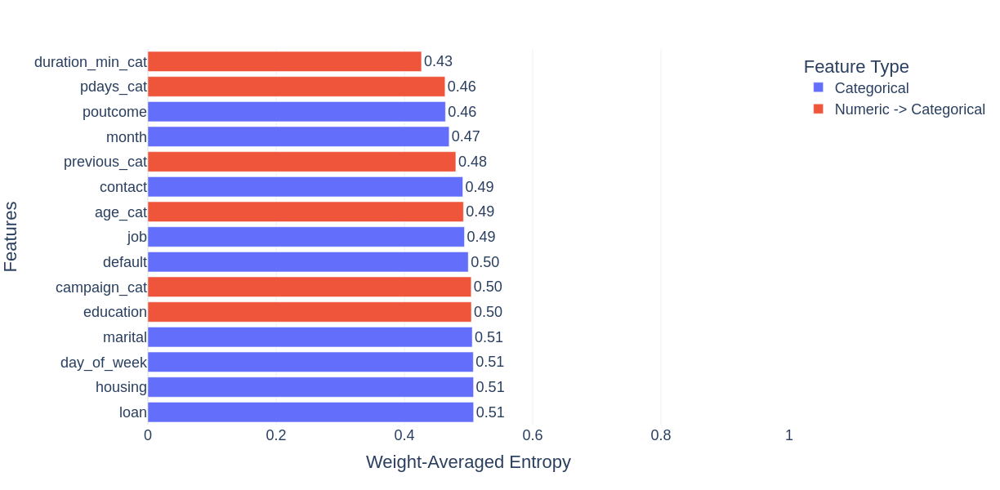

In [139]:
fig = px.bar(df_entropy2.sort_values("entropy", ascending=True),
             y="features",
             x="entropy",
             color="cat_label",
             template="plotly_white",
             category_orders = {"cat_label": ["Categorical", "Numeric -> Categorical"], "features": feat_sort},
             # color_discrete_sequence = ["
             width=800,
             height=600,
             text_auto="0.2f",
             range_x = [0, 1],
             labels={"cat_label": "Feature Type"}
            )

fig.update_traces(textposition="outside")

fig.update_layout(
    # title="Plot Title",
    xaxis_title="Weight-Averaged Entropy",
    yaxis_title="Features",
    # legend_title="Legend Title",
    font=dict(
        family="Arial",
        size=18,
        # color="RebeccaPurple"
    )
)

fig.show()

# Resample

In [120]:
y_choice_yes = np.where(df_raw["y"] == "yes")[0]
y_choice_yes

array([   83,    86,    87, ..., 45206, 45207, 45208])

In [122]:
y_choice_yes.shape

(5289,)

In [124]:
num_no = len(np.where(df_raw["y"] == "no")[0])
num_yes = len(y_choice_yes)

In [60]:
np.random.seed(seed=0)
rand_sample_ind = np.random.choice(y_choice_yes, size=num_no - num_yes, replace=True)
rand_sample_ind.shape

(34633,)

In [128]:
df_resampled_yes = df_raw.loc[rand_sample_ind]
df_resampled_yes

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
39439,43,admin.,single,secondary,no,733,yes,no,cellular,25,may,282,1,187,3,success,yes
38300,31,admin.,married,secondary,no,685,yes,no,cellular,15,may,552,1,329,3,failure,yes
31123,41,technician,divorced,secondary,no,4047,yes,no,cellular,18,feb,343,1,-1,0,unknown,yes
41052,47,unemployed,married,secondary,no,926,no,no,cellular,14,aug,436,1,403,5,success,yes
44448,41,management,married,tertiary,no,1092,no,no,cellular,5,aug,736,1,-1,0,unknown,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44193,63,blue-collar,married,secondary,no,180,no,no,cellular,15,jul,390,2,182,5,success,yes
41617,27,management,single,tertiary,no,20585,no,no,cellular,23,sep,299,1,100,1,success,yes
42806,36,technician,married,tertiary,no,202,no,no,cellular,29,jan,313,1,120,3,failure,yes
26935,36,management,married,tertiary,no,4069,no,no,cellular,21,nov,517,1,-1,0,unknown,yes


In [131]:
df_res = pd.concat([df_raw, df_resampled_yes]).reset_index(drop=True)
df_res

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79839,63,blue-collar,married,secondary,no,180,no,no,cellular,15,jul,390,2,182,5,success,yes
79840,27,management,single,tertiary,no,20585,no,no,cellular,23,sep,299,1,100,1,success,yes
79841,36,technician,married,tertiary,no,202,no,no,cellular,29,jan,313,1,120,3,failure,yes
79842,36,management,married,tertiary,no,4069,no,no,cellular,21,nov,517,1,-1,0,unknown,yes


## Re-examine features

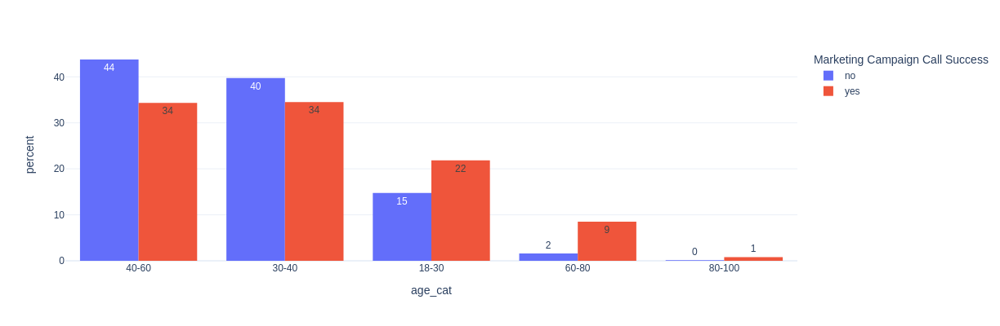

In [135]:
make_prop_hist_cat(df, "age_cat")

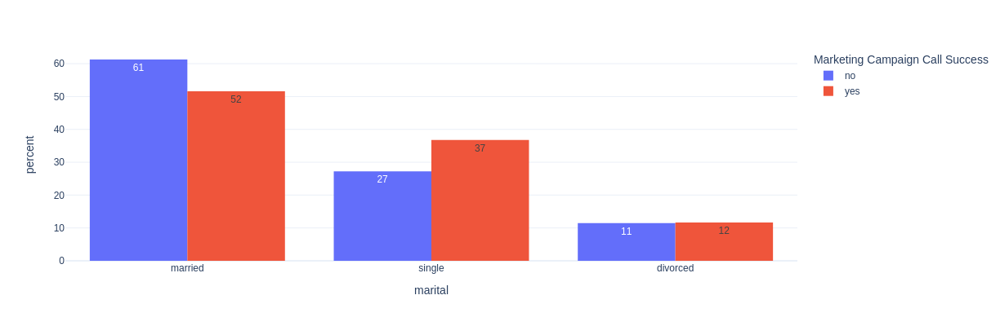

In [136]:
make_prop_hist_cat(df, "marital")

## Recalculate Entropies

### Remake df

In [133]:
df = df_res.copy()

age_bins = [18, 30, 40, 60, 80, 100]
age_labels = ["-".join((str(age_bins[i]), str(age_bins[i+1]))) for i in range(len(age_bins)-1)]
df["age_cat"] = pd.cut(df["age"], bins=age_bins, labels=age_labels, include_lowest=True)

# balance_bins = [-10000, 0, 100, 500, 1000, 2000, 10000, 110000]
balance_bins = [-10000, 0, 1000, 110000]
balance_labels = ["-".join((str(balance_bins[i]), str(balance_bins[i+1]))) for i in range(len(balance_bins)-1)]

df["balance_cat"] = pd.cut(df["balance"], bins=balance_bins, labels=balance_labels, include_lowest=True)
df["balance_split"] = np.where(df["balance"] > 1000, "yes", "no")

df["day_cat"] = make_cat_col(df, "day", [1, 7, 14, 21, 31])

df["duration_min"] = df["duration"]/60
dur_min_bins = [0, 5, 10, 15, 20, 30, 45, 60]
dur_min_labels = ["-".join((str(dur_min_bins[i]), str(dur_min_bins[i+1]))) for i in range(len(dur_min_bins)-1)]
df["duration_min_cat"] = pd.cut(df["duration_min"], bins=dur_min_bins, labels=dur_min_labels, include_lowest=True)


df["campaign_cat"] = make_cat_col(df, "campaign", [0, 1, 2, 3, 10, 63])

df["pdays_cat"] = make_cat_col(df, "pdays", [-1, 0, 90, 180, 365, 900])
                               
df["previous_cat"] = make_cat_col(df, "previous", [0, 1, 2, 3, 4, 5, 50, 300])
df["first_contact"] = np.where(df["previous"] == 0, "yes", "no")

### Resampled Entropies

In [134]:
feat_cat = [
    # 'age', # num
    'job',
    'marital',
    'education',
    'default',
    # 'balance', # num
    'housing',
    'loan',
    'contact',
    # 'day', # num though discrete
    'month',
    # 'duration', # num
    # 'campaign', # num
    # 'pdays', # num
    # 'previous', # num
    'poutcome',
    # 'y', # class label
    'age_cat',
    'balance_cat',
    'balance_split',
    'day_cat',
    # 'duration_min',
    # 'duration_min_cat',
    'campaign_cat',
    'pdays_cat',
    "previous_cat",
    "first_contact",
]

entropy_dict = {"features": feat_cat,
                "entropy": []
               }

for feat in feat_cat:
    entropy_dict["entropy"].append(calc_E(df[feat], df["y"]))
    
df_entropy = pd.DataFrame(entropy_dict)
df_entropy.sort_values("entropy", ascending=True) 

,features,entropy
8,poutcome,0.923491
7,month,0.929083
6,contact,0.947143
14,pdays_cat,0.956567
16,first_contact,0.960841
4,housing,0.966401
9,age_cat,0.968696
15,previous_cat,0.972718
0,job,0.972984
13,campaign_cat,0.984607
